# フィルタリング

In [57]:
import os
import sys
import struct
import pyaudio
import numpy as np
import scipy as sp
import scipy.io.wavfile
import matplotlib.pyplot as plt
from scipy import signal
from IPython.display import Audio
%matplotlib inline

In [58]:
def plot_wave(time, amp, xtitle='Time[s]', ytitle='Amplitude[arb.]', hold=False, color='blue', marker=',', legend='', linestyle='-', stem=False):
    """
    波形プロット
    @Param time         : 時刻の離散データ
    @Param amplitude    : 時刻データに対応する瞬時振幅値
    @Param xtitle       : 横軸ラベル
    @Param ytitle       : 縦軸ラベル
    @Param hold         : False -> 描画, True -> データ保持
    @Param color        : グラフの色
    @Param marker       : マーカの種類
    @Param legend       : 凡例の文字列
    @Param linestyle    : 線の種類
    @Param stem         : False -> 折れ線グラフ, True -> ○付き棒グラフ
    """
    if (len(time) == 0):
        time = range(len(amp))
        if (xtitle == 'Time[s]'):
            xtitle = 'Time[point]'

    if (marker != ','):
        linestyle = ''

    if (stem == False):
        plt.plot(time, amp, color=color, marker=marker, linestyle=linestyle, label=legend)
    else:
        plt.stem(time, amp, label=legend, use_line_collection = True)

    if (legend != ''):
        plt.legend()

    if (hold == False):
        plt.xlabel(xtitle)
        plt.ylabel(ytitle)
        plt.show()

In [59]:
_called_first = True # subplotを2回呼ばないようにする
def plot_FFT_spectrum(sp, fs=48000, level=False, plot_range=60, real_wave=False, phase_spectrum=True, stem=True, color='b', hold=False):
    """
    スペクトルプロット関数
    sp              : スペクトル結果
    fs              : サンプリング周波数[Hz]
    level           : True -> 相対レベル表示(縦軸)
    plot_range      : 縦軸範囲
    real_wave       : 実数波形
    phase_spectrum  : False -> 振幅スペクトルのみ
    stem            : True -> ○付き棒グラフ
    color           : グラフカラー
    hold            : True -> データ保持。
    """
    global _called_first, _ax1_for_FFTspectrum

    amp = np.abs(sp)    # 振幅
    ph = np.angle(sp)   # 位相

    # 振幅がプロット範囲より小さい場合は位相を0へ
    threshold = 10**(-plot_range / 20)*max(amp)
    ph[ amp < threshold ] = 0

    if (fs == None):
        # 横軸を正規化角周波数へ
        if (real_wave == False):
            omega_max = 2*np.pi         # 正規化角周波数は2πまでプロット
            f_number = len(amp)         # 周波数ビンの数
        else:
            omega_max = np.pi           # 正規化角周波数はπまでプロット
            f_number = int(len(amp)/2)  # ナイキスト周波数までの周波数ビンの数
        frequency = np.linspace(0, omega_max, f_number, endpoint=False)
        xtitle = 'Normarized angular frequency[rad]'
    else:
        if (real_wave == False):
            f_max = fs                  # サンプリング周波数までプロット
            f_number = len(amp)         # 周波数ビンの数
        else:
            f_max = fs/2                # ナイキスト周波数までプロット
            f_number = int(len(amp)/2)  # ナイキスト周波数までの周波数ビンの数
        frequency = np.linspace(0, f_max, f_number, endpoint=False) # 基本周波数とその整数倍の周波数の配列
        xtitle = 'Frequency[Hz]'

    ''' 振幅スペクトル '''
    ytitle = 'Amplitude[arb.]'

    if (level == True):
        # 振幅が0の場合にlogの計算エラーが出ないよう、計算機イプシロン(1より大きい最小の数)を加算
        amp = amp + np.finfo(float).eps
        amp = 20*np.log10(np.abs(amp[0:f_number]/np.max(amp[0:f_number])))  # 最大振幅を0[dB]とした相対レベルを計算
        amp = amp + plot_range                                              # stemの描画のため描画範囲を加算
        amp[amp < 0] = 0                                                    # plot_range未満は0
        ytitle = 'Relative level[dB]'

    # 重ねてプロット
    if (_called_first == True):
        _ax1_for_FFTspectrum = plt.subplot(2, 1, 1)
        _called_first = False

    if (stem == True):
        _ax1_for_FFTspectrum.stem(frequency[0:f_number], amp[0: f_number])
    else:
        _ax1_for_FFTspectrum.plot(frequency[0:f_number], amp[0: f_number], color=color)
    if (xtitle == 'Normarized angular frequency (rad)'):
        if (real_wave == False):
            plt.xticks(
                [0, np.pi/2, np.pi, 3*np.pi/2, 2*np.pi],
                ["$0$", "$0.5 \pi$" ,"$\pi$", "$1.5 \pi$", "$2 \pi$"])
        else:
            plt.xticks(
                [0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi],
                ["$0$", "$0.25 \pi$" ,"$0.5 \pi$", "$0.75 \pi$", "$\pi$"])

    plt.xlabel(xtitle)
    plt.ylabel(ytitle)

    if (level == True):
        plt.yticks(
            [i for i in range(0, int(plot_range) + 1, 10)],
            [str(i) for i in range(-int(plot_range), 0+1, 10)])

    if (phase_spectrum == False):
        if (hold == False):
            plt.show()
            _called_first = True
        return

    ''' 位相スペクトル '''
    ytitle = 'Phase[rad]'
    plt.subplot(2, 1, 2)
    if (stem == True):
        plt.stem(frequency[0:f_number], ph[0: f_number])
    else:
        plt.plot(frequency[0:f_number], ph[0: f_number])

    if (xtitle == 'Normarized angular frequency (rad)'):
        if (real_wave == False):
            plt.xticks(
                [0, np.pi/2, np.pi, 3*np.pi/2, 2*np.pi],
                ["$0$", "$0.5 \pi$" ,"$\pi$", "$1.5 \pi$", "$2 \pi$"])
        else:
            plt.xticks(
                [0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi],
                ["$0$", "$0.25 \pi$" ,"$0.5 \pi$", "$0.75 \pi$", "$\pi$"])

    plt.xlabel(xtitle)
    plt.ylabel(ytitle)
    plt.ylim(-np.pi, np.pi)
    plt.yticks(
        [-np.pi, -np.pi/2, 0, np.pi/2, np.pi],
        ["$-\pi$", "$-\pi/2$" ,"0", "$\pi/2$", "$\pi$"])

    if (hold == False):
        plt.show()
        _called_first = True

In [60]:
def hanning_window(N):
    """
    ハニング窓
    N: 窓長
    """
    n = np.arange(0, N)
    window = (0.5-0.5*np.cos(2*np.pi*(n+0.5)/(N)))
    return window

In [61]:
def n_shift_wave(wave, n):
    """
    時間波形をn点だけ円状シフト
    """
    n_shift = (np.r_[wave[-n:], wave[:-n]])
    return n_shift

入力された信号に対して、雑音を除去したり、何らかの変化を与えることを**フィルタリング**という。ディジタルフィルタは、FIR(Finite Impluase Response)とIIR(Infinite Impluse Response)の2つに大別される。

## FIRフィルタ

入力 $x(n)$ があり、出力 $y(n)$ があるものをシステム $S$ と定義する。例えば、オーディオアンプは、振幅の小さな音の信号を入力し、振幅を大きくした音の信号を出力するシステムである。あるシステムにインパルス(単位パルス) $u(n)$ を入力すると、出力 $h(n)$ が得られる。この出力を、**インパルス応答**という。

コンサートホールで考えてみると、長さ1点の単位パルス $u(n)$ が、スピーカーから放射された後、空気中を伝搬し、直接音としてマイクロホンに届く。その後も、響きである壁や天井からの反射音もマイクロホンに到達するので、N点の長さをもつインパルス応答 $h(n)$ が得られる。つまり、響きが多ければ $N$ は大きな値をとる。$x(n)$ を与えたとき、出力 $y(n)$ は、**畳込み**(Convolution)で与えられる。

畳込みは、次式で表される( $*$ は畳込みを表す)。

$ y(n) = h(n) * x(n) = \Sigma^{N-1}_{k=0}h(n)x(n-k) $

ここで重要なのは、$N$ 点の信号と $M$ 点の信号を畳込んだ結果は、$N + M - 1$ となる。これは、処理する前の音を $M$ 点の信号 $x(n)$ とし、ホールの響きを $N$ 点の信号 $h(n)$ とすると、$M$ 点の最後のパルスに関する直接音から反射音までが到達したものが $N$ 点の長さになると考えられる。そうすると、それまでに $M - 1$ 点の直接音が届いていることになり、その末尾に $N$ 点の音がつながるため、全体としては $(M - 1) + N = N + M -1$ 点となる。

まず、コンサートホールのインパルス応答を確認するためのサンプルの音源を聞いてみる。

Sampling frequency :  44100 [Hz]


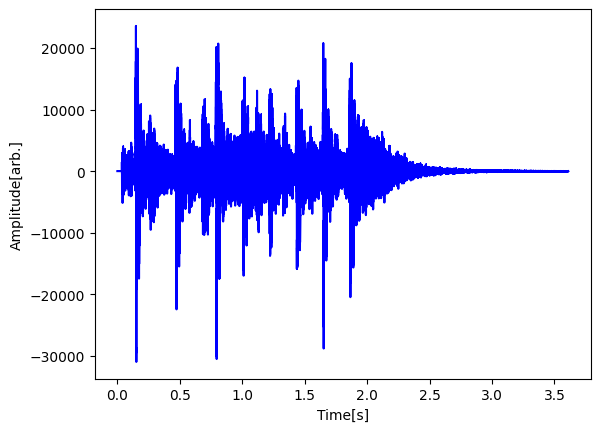

In [62]:
fs, wave_data = scipy.io.wavfile.read ('sample/sample_4.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs                           # サンプリング周期
t = np.arange (len(wave_data))*ts   # サンプリング期間
plot_wave(t, wave_data)
audio = Audio(wave_data, rate=fs)
audio

続いて、コンサートホールのインパルス応答を聞いてみる。

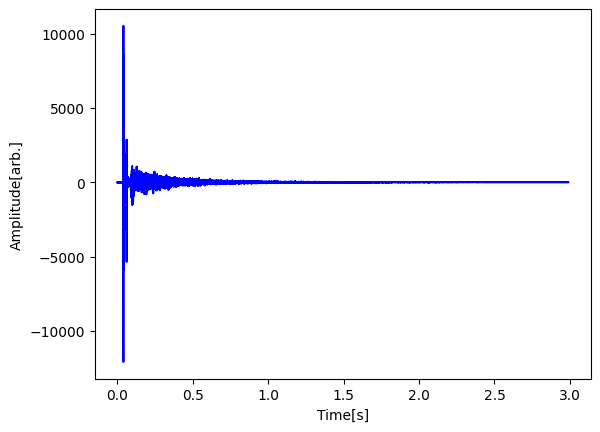

In [63]:
fs, ir = scipy.io.wavfile.read ('sample/sample_5.wav')
t = np.arange(len(ir))*ts
plot_wave(t, ir)
audio = Audio(ir, rate=fs)
audio

この2つの音源を畳込む。

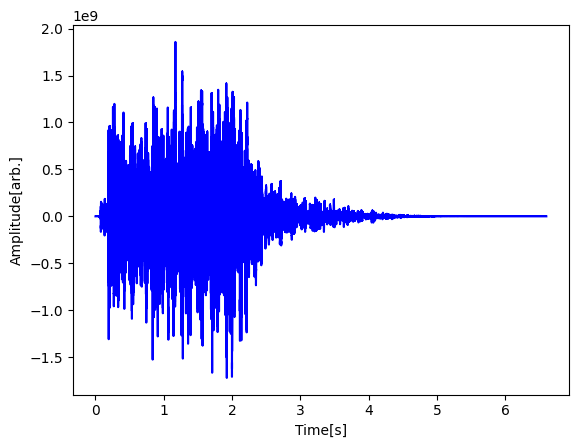

In [64]:
# 畳込み
convolve_result = np.convolve(ir.astype(float), wave_data.astype(float))
t = np.arange(len(convolve_result))*ts
plot_wave(t, convolve_result)
audio = Audio(convolve_result, rate=fs)
audio

響きのある音になったことがわかる。

int16型の状態で畳込んでみる。

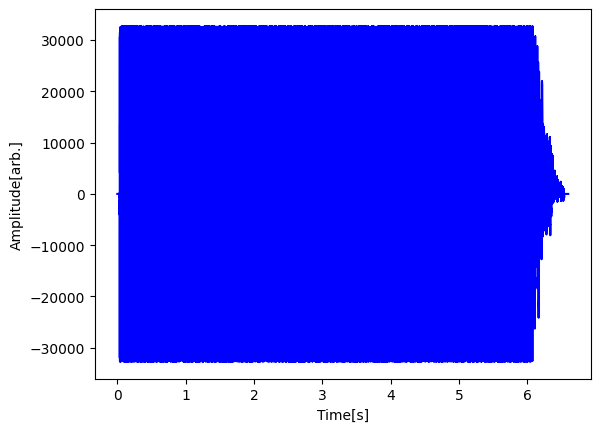

In [65]:
# int16型の状態で畳込む
convolve_result = np.convolve(ir, wave_data)
t = np.arange(len(convolve_result))*ts
plot_wave(t, convolve_result)
audio = Audio(convolve_result, rate=fs)
audio

int16型の状態だとオーバーフローしてしまい、上手く畳込むことができないよう。

FIRフィルタの出力 $y(n)$ は、現在である $k=0$ と、過去である $k = 1, 2, 3, \cdots, N -1 $ の入力 $x(n - k)$ に、フィルタ係数 $b(k) (k = 1, 2, 3, \cdots, N -1 $)$ という重みを掛けて加算する。これを式で表すと次のようになる。

$ y(n) = \Sigma^{N-1}_{k=0}b(k)x(n-k) $

この式は、畳込みの式と瓜二つである。

$ y(n) = h(n) * x(n) = \Sigma^{N-1}_{k=0}h(n)x(n-k) $

つまり、フィルタ係数 $b(k)$ を求めることがフィルタを設計することであり、フィルタを設計するということは、そのフィルタのインパルス応答を定めることと同じである。また、このフィルタのインパルス応答の長さは、 $N$ という有限の値となるので、FIR(Finite Impulse Response)型という。

フィルタの種類としては、次の4種類がある。
- LPF(Low Pass Filter : 低域通過フィルタ)
- HPF(High Pass Filter : 高域通過フィルタ)
- BPF(Band Pass Filter : 帯域通過フィルタ)
- BSF(Band Stop Filter : 帯域阻止フィルタ)

FIRフィルタの設計は、インパルス応答を求めるに等しいので、次のような手順となる。

1. 遮断周波数を決め、その周波数未満では振幅1を、それ以上は振幅0となるようなスペクトルを用意する。フィルタにおいて、振幅1を掛けるということは、変化を与えないということであり、振幅0を掛けるということは、除去するということを意味する。
2. 逆FFTしてインパルス応答を求める。
3. 必要に応じて円状シフトし、窓関数を掛ける。

FIRのLPFを自作してみる。ここでは、サンプリング周波数44.1[kHz]の音に対し、6[kHz]未満の成分のみを通過させるLPFを実装してみる。フィルタ係数の長さである**タップ数**は64とする。

まず、1番のスペクトルを用意する。

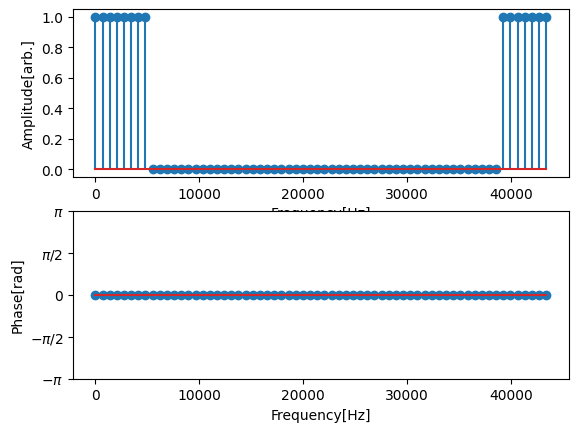

In [66]:
fs = 44.1e3                     # サンプリング周波数
N = 64                          # タップ長
fc = 6e3                        # 遮断周波数(カットオフ周波数)
df_c = int(np.floor(fc/fs*N))   # 遮断周波数に対応する周波数ビンを算出
H = np.zeros(N)                 # 全周波数ビンの振幅を0で初期化
H[0:df_c] = 1                   # 遮断周波数未満は振幅を1へ
H[-df_c+1: ] = 1                # 負の周波数領域における振幅値を1へ
plot_FFT_spectrum(H, fs)

次に、2番の逆FFTしてインパルス応答を求めてみる。


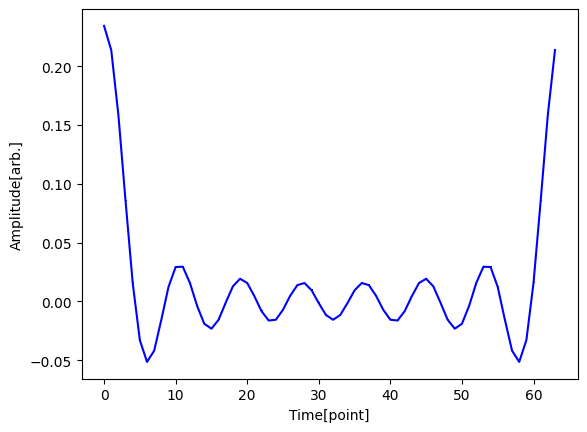

In [67]:
h = np.real(np.fft.ifft(H)) # 虚部は無視
plot_wave([], h)

スペクトルの観測では、振幅スペクトルは偶関数、位相スペクトルは奇関数であるため、負の周波数の部分は見る必要はない。

次に、3番目の、必要に応じて円状シフトし、窓関数を掛けてみる。

今回は直線畳込みを行うため、円状シフトを行う(フィルタリングを巡回畳込みで行う場合は、円状シフトする必要はない)。

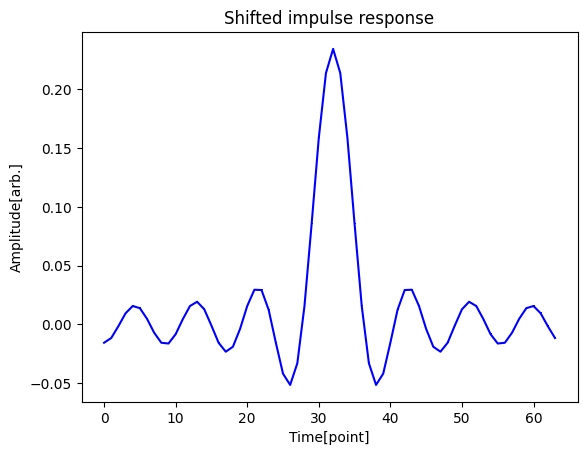

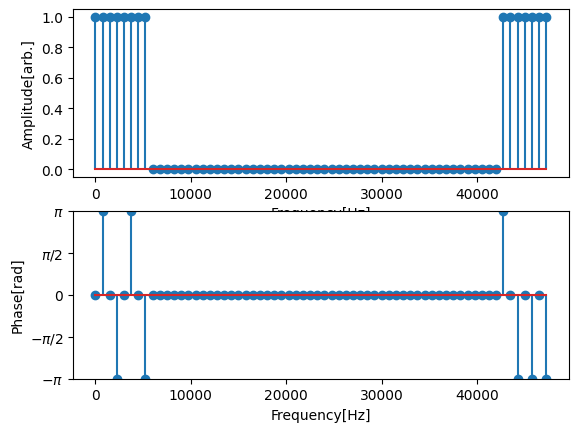

In [68]:
# 円状シフト
h_shifted = n_shift_wave(h, int(N/2))
plt.title('Shifted impulse response')
plot_wave([], h_shifted)

H_shifted = np.fft.fft(h_shifted)
plot_FFT_spectrum(H_shifted, level=False)

円状シフトにより、フィルタの出力に遅延が発生する。しかし、音声においては多少遅れて音が聞こえてくるだけで、特段の問題にはならない。

インパルス応答を見ると、まだ両端に不連続が起きそうなので、ハニング窓を掛け、両端を0に収束させる。

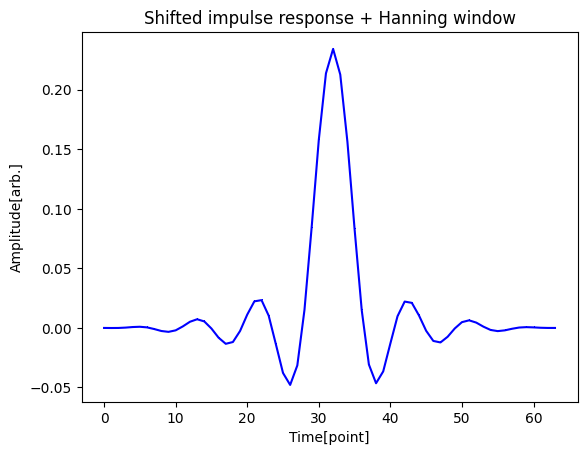

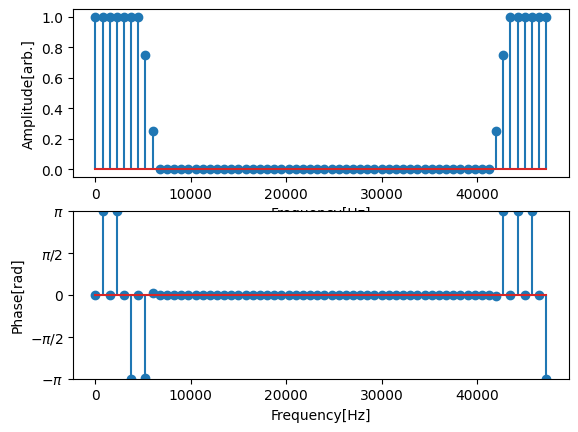

In [69]:
wn = hanning_window(N)
h_final = wn*h_shifted
plt.title('Shifted impulse response + Hanning window')
plot_wave([], h_final)
H_final = np.fft.fft(h_final)
plot_FFT_spectrum(H_final, level=False)

この波形は、理想的なLPFのインパルス応答を窓掛けによって打ち切ったものとみなすことができ、このようなフィルタ設計法を**窓関数法**という。

振幅スペクトルを見ると、遮断特性もゆるくなり、6[KHz]以上の周波数も多少漏れ、6[kHz]未満の周波数成分は若干小さくなっている。-3[dB]低下する、パワーでいうと $1/2$、振幅でいうと $1/\sqrt{2}$ になる周波数を**フィルタの遮断周波数**という。

次に、実際にサンプルの音源を使って、LPFで重畳した雑音を除去してみる。

Sampling frequency :  44100 [Hz]


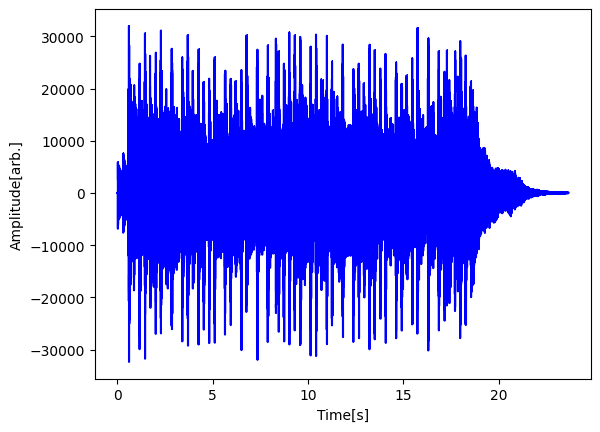

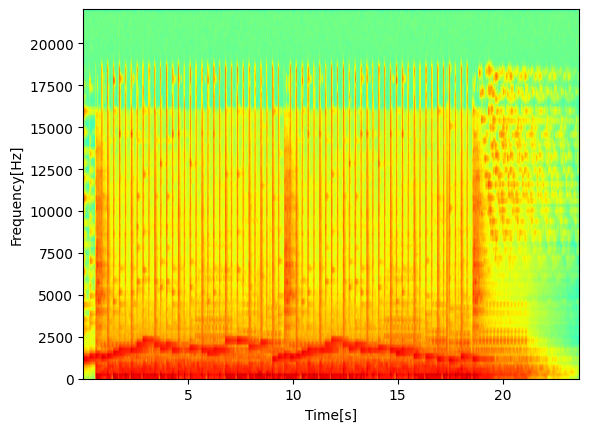

In [70]:
fs, original_wave_data = scipy.io.wavfile.read('sample/sample_6.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs
t = np.arange(len(original_wave_data))*ts

plot_wave(t, original_wave_data)
plt.specgram(original_wave_data, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(original_wave_data, rate=fs)
audio

サンプルの音源に雑音を重畳する。

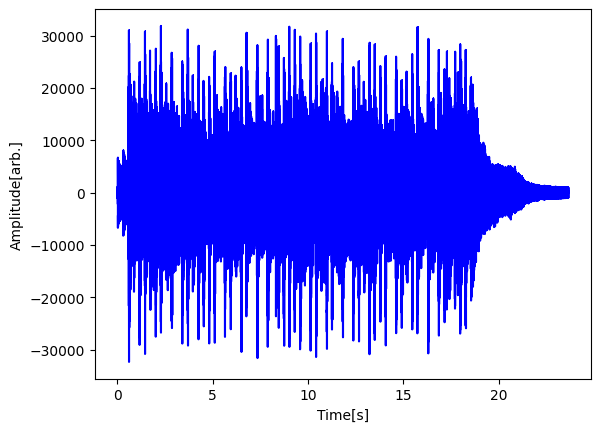

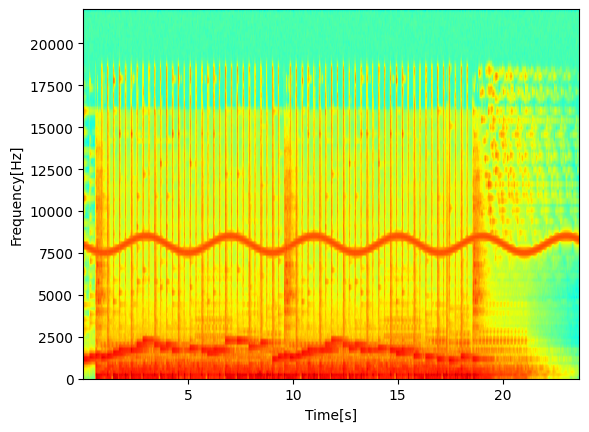

In [71]:
wave_data = original_wave_data.copy()
mod = 2e3*np.cos(2*np.pi*0.25*t)
noise = 1000*np.sin(2*np.pi*8e3*t + mod)
wave_data += noise.astype(int)  # 雑音を重畳
plot_wave(t, wave_data)
plt.specgram(wave_data, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(wave_data, rate=fs)
audio

聞いてみると雑音が混じっていることがわかる。

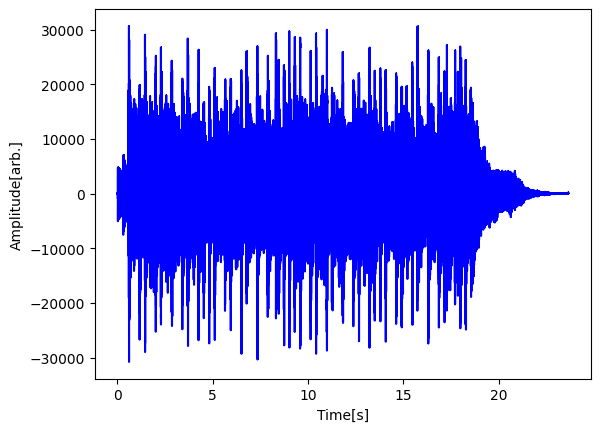

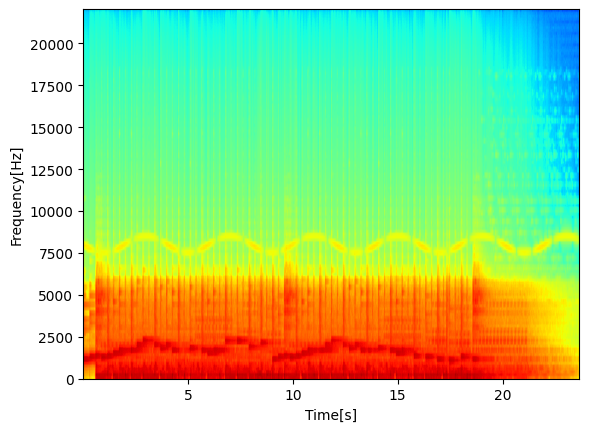

In [72]:
convolve_result = np.convolve(h_final, wave_data.astype(float))
t = np.arange(len(convolve_result))*ts

plot_wave(t, convolve_result)
plt.specgram(convolve_result, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(convolve_result, rate = fs)
audio

スペクトログラムで見ると微かに雑音が残っているように見えるが、聞いてみると雑音が消えている。

次は、scipyのライブラリを使用し、FIRフィルタを窓関数法で自動設計してみる。

SciPyの信号処理パッケージ : [Signal processing](https://docs.scipy.org/doc/scipy/reference/signal.html)

FIRフィルタ設計 : [scipy.signal.firwin](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.firwin.html#scipy.signal.firwin)

これまで同様、44.1[kHz]のサンプリング周波数に対し、6[Khz]未満の成分のみを通過させるLPFを実装する。

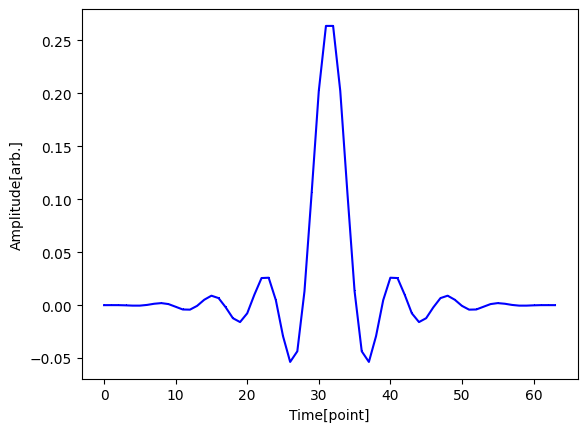

In [73]:
N = 64
fc = 6e3 / (fs/2)                       # 遮断周波数はナイキスト周波数に対する比で指定
h = signal.firwin(N, fc, window='hann') # ハニング窓でフィルタを設計
plot_wave([], h)

Sampling frequency :  44100 [Hz]


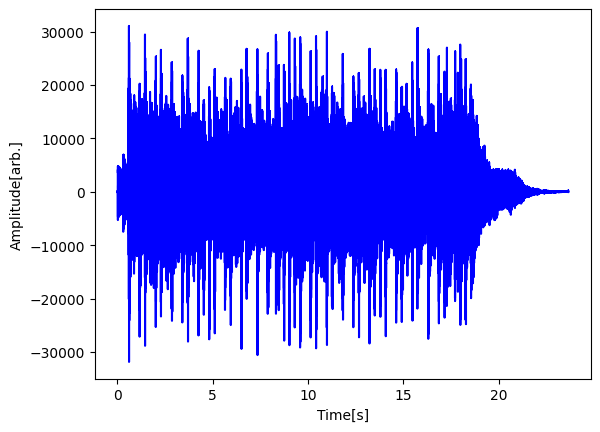

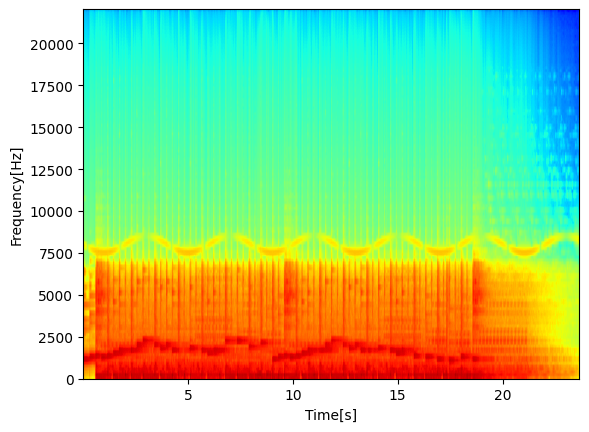

In [74]:
fs, wave_data_original = scipy.io.wavfile.read('sample/sample_6.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs
t = np.arange(len(wave_data))*ts
wave_data = wave_data_original.copy()

mod = 2e3*np.cos(2*np.pi*0.25*t)
noise = 1000*np.sin(2*np.pi*8e3*t + mod)
wave_data += noise.astype(int)  # 雑音を重畳

# 畳込み
convolve_result = np.convolve(h, wave_data.astype(float))

t = np.arange(len(convolve_result))*ts
plot_wave(t, convolve_result)

plt.specgram(convolve_result, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(convolve_result, rate=fs)
audio

フィルタリングによって、重畳された雑音が除去できていることがわかる。

次は、雑音を重畳せずに、カット周波数を8[kHz] (ラジオのAM放送なみ)や3.4[kHz] (電話音声なみ)にしてフィルタリングするとどうなるのか見てみる。

まず、元の音源をもう一度聞く。

In [75]:
audio = Audio(wave_data_original, rate=fs)
audio

カット周波数を8[kHz] (ラジオのAM放送なみ)にしてみる。

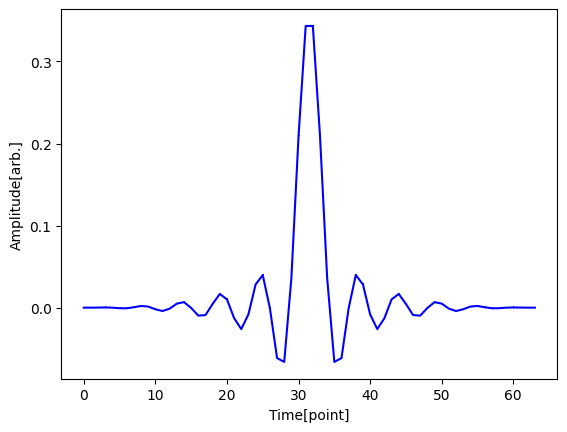

In [76]:
N = 64
fc = 8e3 / (fs/2)                       # 遮断周波数はナイキスト周波数に対する比で指定
h = signal.firwin(N, fc, window='hann') # ハニング窓でフィルタを設計
plot_wave([], h)

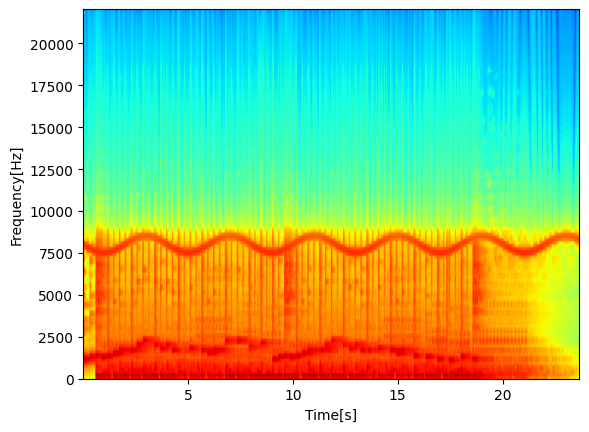

In [77]:
# 畳込み
convolve_result = np.convolve(h, wave_data.astype(float))
t = np.arange(len(convolve_result))*ts
plt.specgram(convolve_result, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(convolve_result, rate=fs)
audio

高域の音が遮断され、軽い音になった。

カット周波数を3.4[kHz] (電話音声なみ)にしてみる。

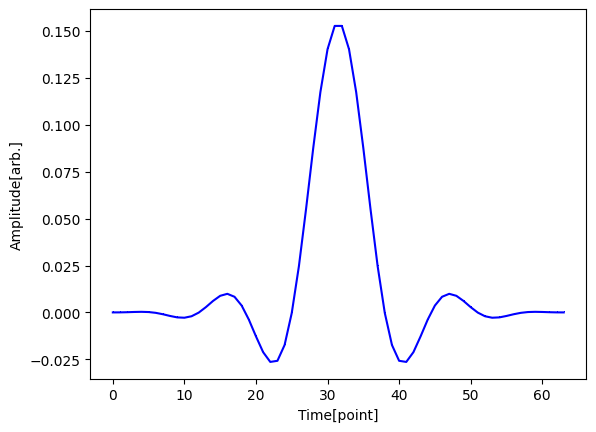

In [78]:
N = 64
fc = 3.4e3 / (fs/2)                     # 遮断周波数はナイキスト周波数に対する比で指定
h = signal.firwin(N, fc, window='hann') # ハニング窓でフィルタを設計
plot_wave([], h)

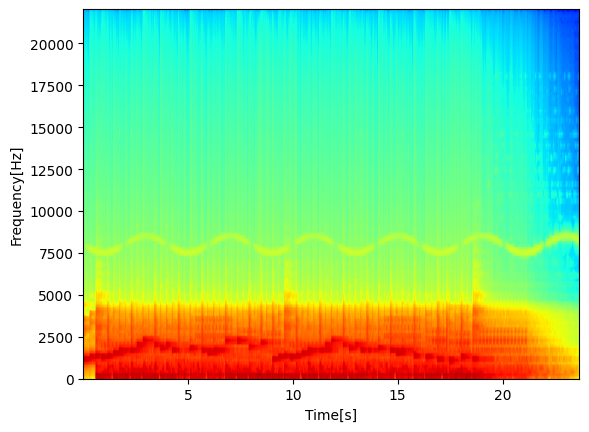

In [79]:
# 畳込み
convolve_result = np.convolve(h, wave_data.astype(float))
t = np.arange(len(convolve_result))*ts
plt.specgram(convolve_result, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(convolve_result, rate=fs)
audio

かなり高域の音が遮断され、軽い音になった。しかし、電話で音声を聞く分には十分であることがわかる。

次に、5[kHz]のカット周波数のHPFを設計し、フィルタリングしてみる。

※フィルタ長は奇数にする必要がある。

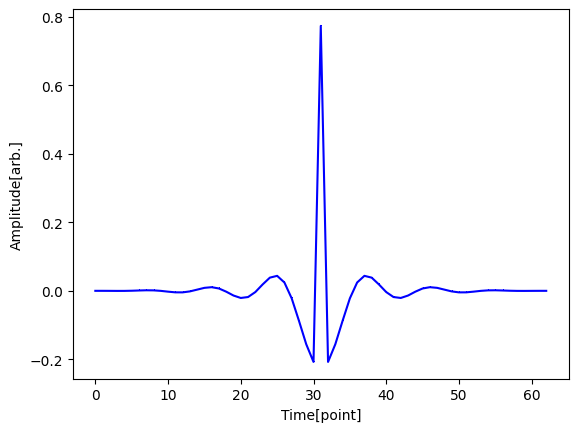

Sampling frequency :  44100 [Hz]


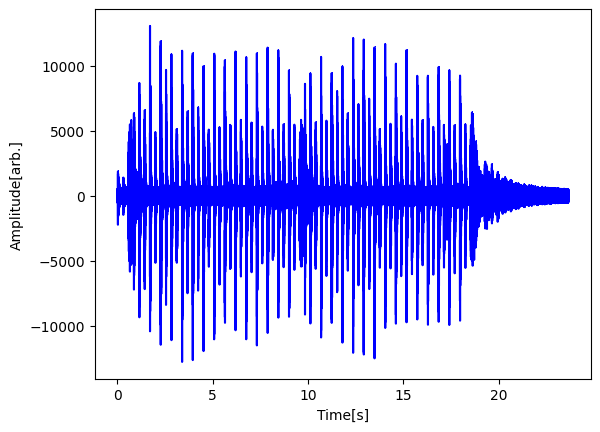

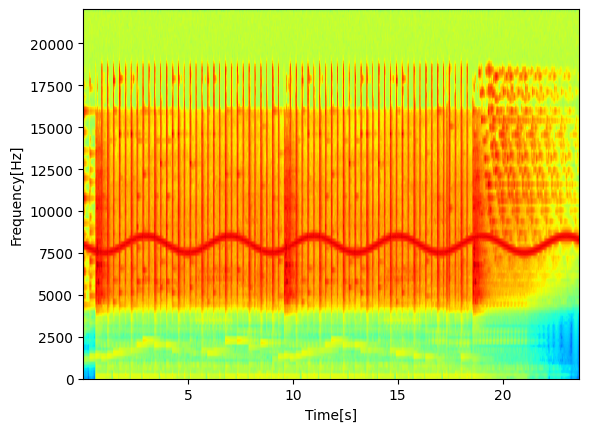

In [80]:
N = 63
fc = 5e3/(fs/2)                                             # 遮断周波数はナイキスト周波数に対する比で指定
h = signal.firwin(N, fc, pass_zero=False, window='hann')    # HPFを設計
plot_wave([], h)

fs, wave_data_original = scipy.io.wavfile.read ('sample/sample_6.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs
t = np.arange ( len ( wave_data )) * ts
wave_data = wave_data_original.copy()

mod = 2e3*np.cos(2*np.pi*0.25*t)
noise = 500*np.sin(2*np.pi*8e3*t + mod)
wave_data += noise.astype(int)  # 雑音を重畳

# 畳み込み
convolve_result = np.convolve(h, wave_data.astype(float))

t = np.arange(len(convolve_result))*ts
plot_wave ( t, convolve_result )

plt.specgram(convolve_result[:], NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(convolve_result[:], rate=fs)
audio

音源の高周波成分と周波数変動する雑音が聞こえるのがわかる。

## IIRフィルタ

IIRフィルタの出力 $y(n$ は、現在及び過去の入力 $x(n-k) (k=0,1,2, \cdots , N-1)$ と、過去の出力 $y(n-k) (k=0,1,2, \cdots , M-1)$ を利用し、これらにフィルタ係数 $b(k) (k=0,1,2, \cdots , N-1), a(k) (k=0,1,2, \cdots , M-1) $ を掛けて加算する。これを式で表すと次のようになる。

$ y(n) = \Sigma^{N-1}_{k=1}a(k)y(n-k) + \Sigma^{N-1}_{k=0}b(k)x(n-k) $

この式の右辺第2項は、FIRを同じであるため、IIRフィルタの本質は右辺第1項にある。

ひとたび出力 $y(n)$ が値をもつと、その値は次のサンプリング点の出力には $y(n-1)$ として右辺に出現する。つまり、ひとたび出力があれば、その後は無限に出力が続くため、IIR(Infinite Inpulse Responmse)型という。

IIRフィルタは、FIRフィルタに比べ次のような性質がある。
- FIRフィルタに比べ、短いタップ長で同等の性能を実現でき、計算量対効果が大きい
- 出力が巡回するため、場合によっては発振することがある(FIRフィルタでは発振の心配がない)。
- FIRフィルタは窓関数法のように、初学者でも設計できる一方で、IIRフィルタは、微分方程式といった周辺知識がないと自分で設計するのは困難。

IIRは設計が難しいため、Scipyで設計を行う。IIRの次数は16とする。遮断特性を見るために、インパルス応答を128点で計算し、相対レベルで表示する。

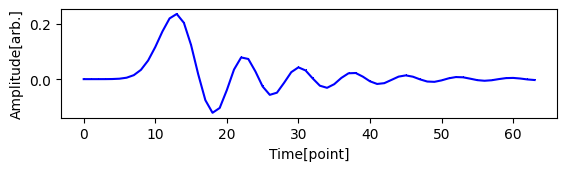

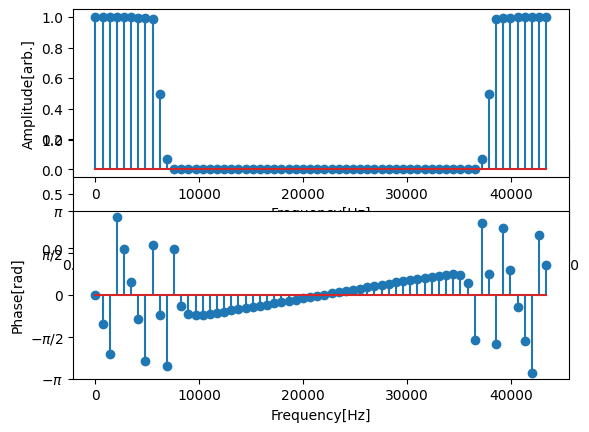

In [81]:
N = 16                                          # IIRの次数
fc = 6e3 / (fs/2)                               # 遮断周波数はナイキスト周波数に対する比として指定
b, a = signal.iirfilter(N, fc, btype='lowpass') # 係数b(k), a(k)の計算

# インパルス応答を128点分計算
ir_N = 64
unit_pulse = np.append(
    np.array([1]),
    np.array([0 for i in range(ir_N-1)]))
y = signal.lfilter(b, a, unit_pulse)

plt.subplot(3,1,1)
plot_wave([],y)

fft_result = np.fft.fft(y)
plt.subplot(3,1,2)
plot_FFT_spectrum(fft_result, fs)

かなり急峻な遮断特性を得ることができた。

設計したIIRフィルタを用いて、雑音を除去してみる。まず、オリジナルの音源をインポートし、雑音を重畳させる。

Sampling frequency :  44100 [Hz]


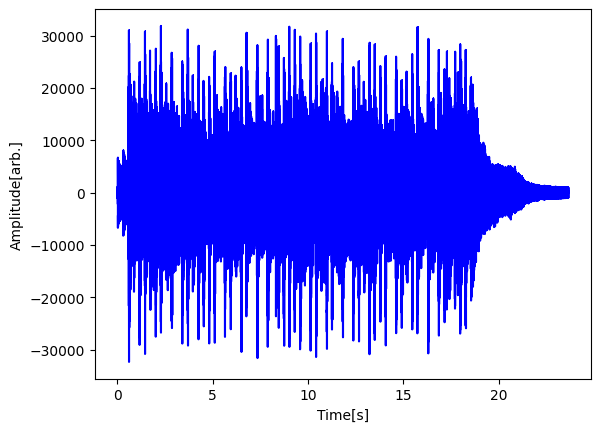

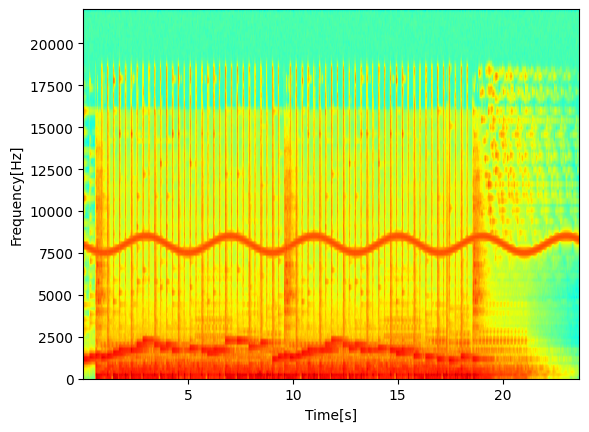

In [82]:
fs, wave_data_original = scipy.io.wavfile.read('sample/sample_6.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs
t = np.arange(len(wave_data))*ts
wave_data =  wave_data_original.copy()

# 雑音を重畳
mod = 2e3*np.cos(2*np.pi*0.25*t)
noise = 1000*np.sin(2*np.pi*8e3*t + mod)
wave_data += noise.astype(int)
plot_wave(t, wave_data)
plt.specgram(wave_data, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(wave_data, rate = fs)
audio

設計したIIRフィルタを使って雑音を除去する。

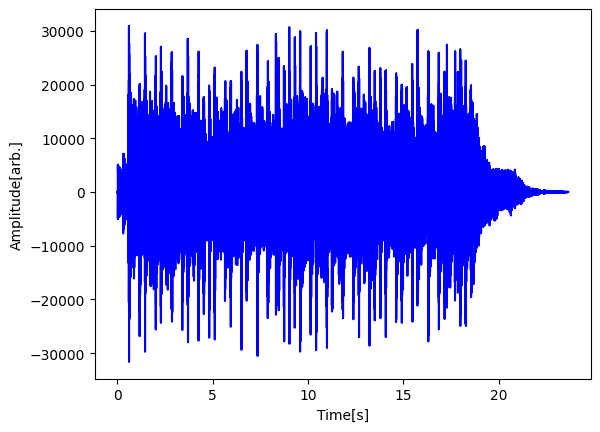

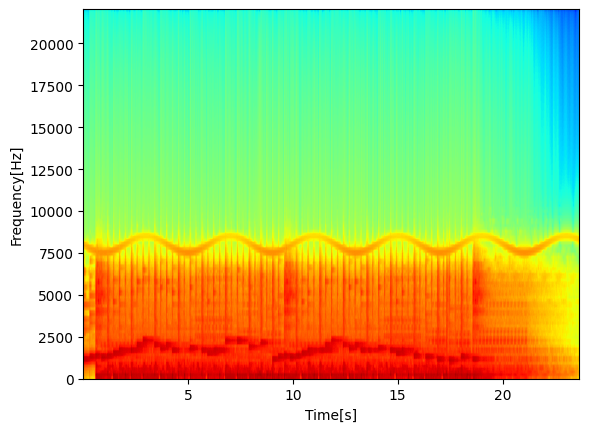

In [83]:
filtered_result = signal.lfilter(b, a, wave_data)
t = np.arange(len(filtered_result))*ts
plot_wave(t, filtered_result)
plt.specgram(filtered_result, NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()
audio = Audio(filtered_result, rate = fs)
audio

高周波成分の音と雑音が除去できていることがわかる。

次数16のIIRフィルタを設計と同等の遮断特性を得るためには、FIRフィルタでは次数(タップ長)をどれくらいの値にするのか考える。

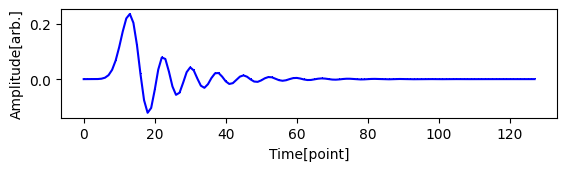

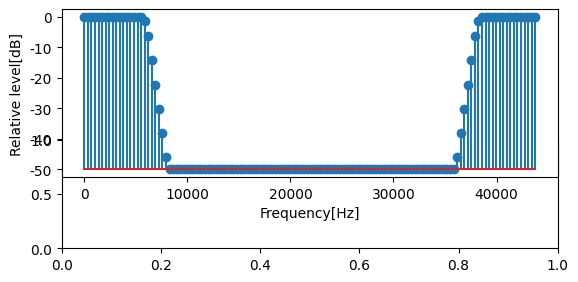

In [84]:
N = 16                                          # IIRの次数
fc = 6e3 / (fs/2)                               # 遮断周波数はナイキスト周波数に対する比として指定
b, a = signal.iirfilter(N, fc, btype='lowpass') # 係数b(k), a(k)の計算

# インパルス応答を128点分計算
ir_N = 128
unit_pulse = np.append(
    np.array([1]),
    np.array([0 for i in range(ir_N-1)]))
y = signal.lfilter(b, a, unit_pulse)

plt.subplot(3,1,1)
plot_wave([],y)

fft_result = np.fft.fft(y)
plt.subplot(3,1,2)
plot_FFT_spectrum(fft_result, fs, level=True, plot_range=50, phase_spectrum=False)

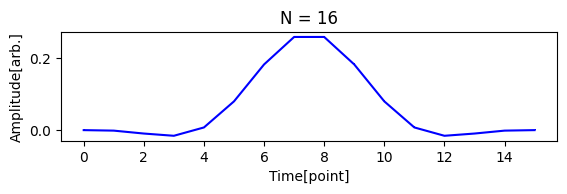

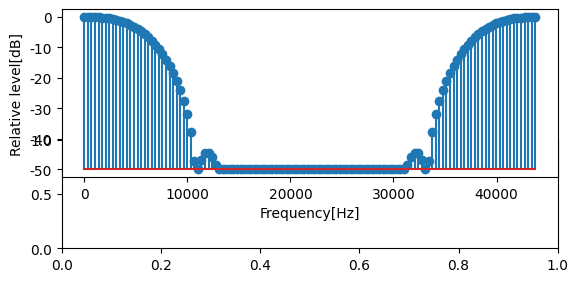

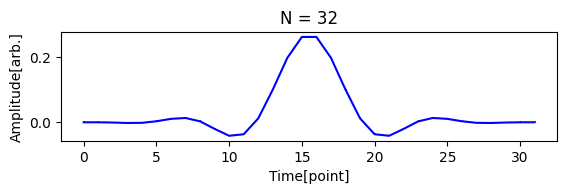

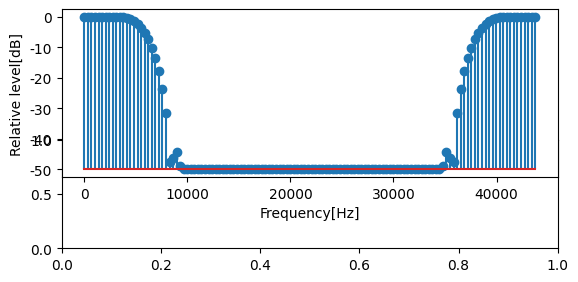

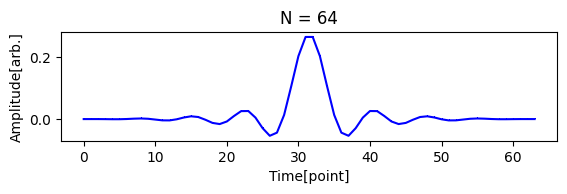

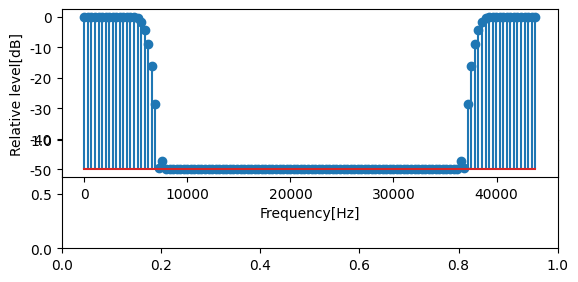

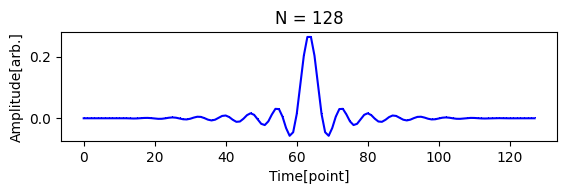

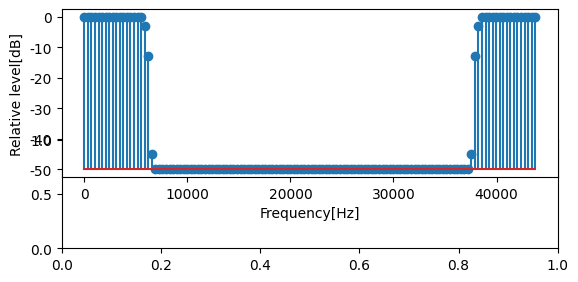

In [85]:
fc = 6e3 / (fs/2)

N_candidate = [2**i for i in range(4, 8)]

for N in N_candidate:
    h = signal.firwin(N, fc, window='hann')
    plt.subplot(3,1,1)
    plt.title("N = " + str(N))
    plot_wave([], h)
    # 単位パルスに畳込み
    result = np.convolve(h, unit_pulse)[0:ir_N] # 最初のir_N点だけ取出す
    fft_result = np.fft.fft(result)
    plt.subplot(3,1,2)
    plot_FFT_spectrum(fft_result, fs, level=True, plot_range=50.0, phase_spectrum=False)

FIRの次数が16だと明らかに遮断特性が劣り、64次くらいでほぼ同等となりそう。これは、16次のIIRのインパルス応答が、ほぼ70点くらいで収束することに対応している。

次に、7[kHz]~9[kHz]の帯域のみを通過させるBPFを設計し、雑音成分だけを取りしてみる。

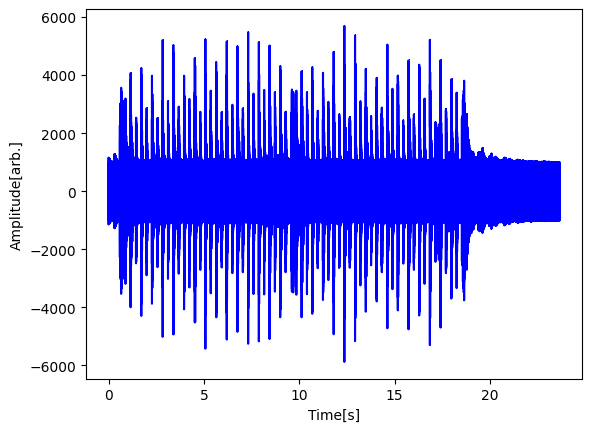

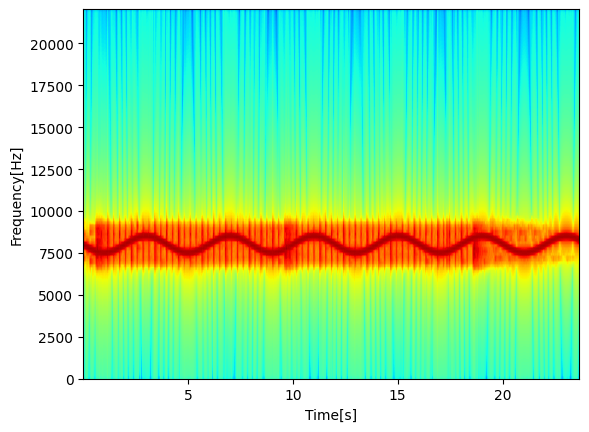

In [86]:
N = 13                                                          # IIRの次数
fc_low  = 7e3 / (fs/2)
fc_high = 9e3 / (fs/2)
b, a = signal.iirfilter(N, [fc_low, fc_high], btype='bandpass') # 係数b(k), a(k)を計算
filtered_result = signal.lfilter(b, a, wave_data)

t = np.arange(len(filtered_result))*ts
plot_wave(t, filtered_result)
plt.specgram(filtered_result[:], NFFT=256, Fs=fs, cmap='jet')
plt.ylabel('Frequency[Hz]')
plt.xlabel('Time[s]')
plt.show()

audio = Audio(filtered_result[:], rate = fs)
audio

雑音だけを取り出すことができた。

## 頭部伝達関数

音源に近い側の耳には、遠い側の耳よりも強い音が早いタイミングで到達する。このとき脳は，両耳に到達した音の違いである、両耳間差を分析し、どの方向に音源があるかを計算する。このように、主観的に捉えた音源を**音像**といい、その位置を察知すること**音像定位**という。

そこで、スピーカが1つの場合についてを考えてみる。しかし、2チャネルスピーカーから同じ音が出力された場合は、音像はそれら音源であるスピーカーの中央に定位する。例えば、ステレオで録音された音源では、ボーカルは2つのスピーカーの中央から聞こえるように感じる。

水平面における方向(方位角)の知覚は、両耳に到達した音の違いで説明ができるが、両耳から等距離にある点が含まれる面の正中面に音源がある場合は、両耳間に強度差や時間差がない。そういった場合でも、音源の仰角を察知することができるのはどうしてなのか。その答えは、音源から放射される音が同じであっても、仰角が異なると耳に到達した音のスペクトルは異なるからである。耳介は複雑な凹凸があり、到来方向によって共鳴・反共鳴の特性が変わり、音源の仰角を察知することができる。人間は、その周波数特性(スペクトル)の特徴と仰角の関係を日常的に学習しているため、音を聞いただけで音源の仰角を察知できる。逆に言えば、耳介に何かしらを詰めると、仰角知覚が一気に不正確になり、数週間すると仰角知覚が可能になったという実験論文もある。

これらの水平面内・正中面内における音像定位は、**頭部伝達関数**(HRTF: Head-Related Transfer Function)によって説明できる。音源から放射された音は、直接音や頭部を回折した音、肩などで反射して外耳に到達する。さらに耳介の共鳴・反共鳴によって、特定の周波数域が強められたり、弱められたりして外耳道へと導かれ、鼓膜を揺らす音となる。もし音源としてスピーカ1つを用意し、それにインパルスを入力すると、両耳の外耳道入口にマイクロホンを置けば、上記の直接音・回折音・反射音・共鳴・反共鳴のすべてが含まれた音を左右耳のインパルス応答である、$hL(n), hR(n)$ として記録できる。これは**頭部インパルス応答**(HRIR: Head-Related Impulse Response)という。インパルス応答に対応するスペクトルが、そのシステムの伝達関数なので、結局、左右耳での到達音の違い及び音源の仰角によるスペクトルの変化は、すべて頭部伝達関数または頭部インパルス応答によってわかる。音源の仰角を系統的に変化させると、頭部伝達関数におけるスペクトルの谷であるノッチが、系統的に変化する。人間は、このスペクトルの特徴を学習し、音像の仰角知覚を可能にしている。このように、音像定位の本質は、頭部伝達関数の両耳間差やピーク・ディップ特性にあるため、**HRTFを用いた音像制御**といった表現をする。

音楽がスピーカーから放射され、耳に到達する音は、スピーカーに入力した音源の信号 $x(n)$ に HRIR $h_L(n), h_R(n)$ を畳込んだもの、あるいは音源の信号のスペクトル $X(n)$ に HRIR $H_L(k), H_R(k)$ を掛けたものとして表現できる。従って、例えば聴取者の左45°前方に実際のスピーカーを置いたときに両耳に到達する音、$h_L(n) * x{n}, h_R(n) * h(x)$ を予め計算しヘッドホンで聞くと、左前方から聞こえるような状況を模擬することができる。これは、音のVR技術で扱われる。

以上を踏まえ、頭部伝達関数を使ってみる。まず、HRIR(頭部伝達関数)のサンプルデータを読込む関数を定義する。

In [87]:
def read_text_data(file_name):
    """
    数値データ読込み
    file_name: ファイル名
    """
    data = np.array([])
    f = open(file_name)
    for line in f:
        data = np.append(data, float(line))
    f.close()
    return data

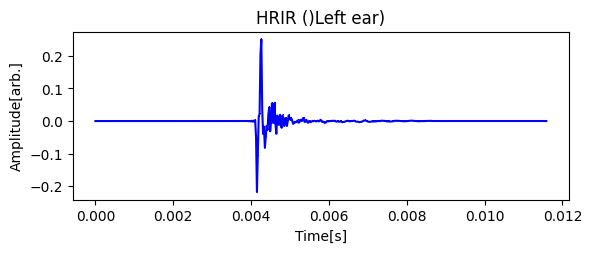

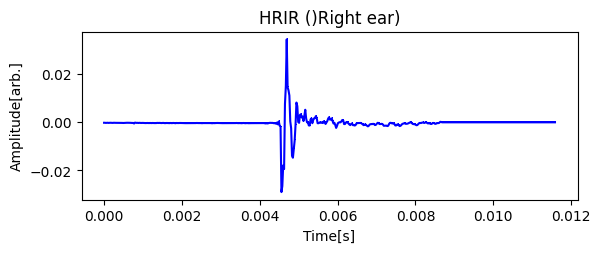

In [88]:
fs = 44100
ts = 1/fs
LR = {"Left":0, "Right":1}

hrir_L = read_text_data('sample/L0e045a.dat')
hrir_R = read_text_data('sample/R0e045a.dat')

hrir_len = min(len(hrir_L), len(hrir_R))
hrir = np.zeros((2, hrir_len))           # 両耳のデータを納める2次元配列を用意します。
hrir[LR["Left"]]  = hrir_L[0:hrir_len]
hrir[LR["Right"]] = hrir_R[0:hrir_len]

t = np.arange(hrir_len)*ts

for lr in LR:
    plt.subplot(2, 1, LR[lr]+1)
    plt.title("HRIR ()" + lr + " ear)")
    plot_wave(t, hrir[LR[lr]])

左前方に音源があるので、左耳の方に早く、強い音が直接届いているのがわかる。

畳込む前にオリジナルの音源を確認する。

Sampling frequency :  44100 [Hz]


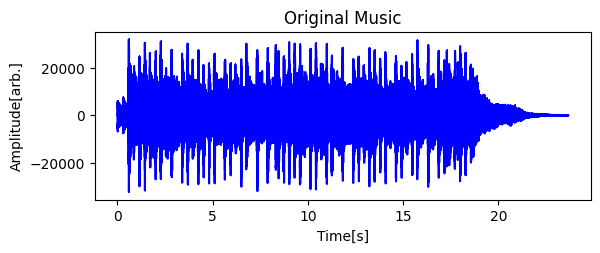

In [89]:
fs, wave_data = scipy.io.wavfile.read('sample/sample_6.wav')
print('Sampling frequency : ', fs, '[Hz]')
ts = 1/fs
t = np.arange(len(wave_data))*ts
plt.subplot(2, 1, 1)
plt.title("Original Music")
plot_wave(t, wave_data)

audio = Audio(wave_data, rate=fs)
audio

オリジナルの音源は、**頭内定位**となっており、ちゃんと頭の中から聞こえている。

次に、この音をHRIRデータで畳込んで左45°前方から聞こえるようにしてみる。

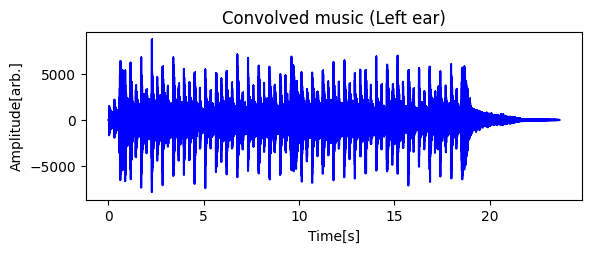

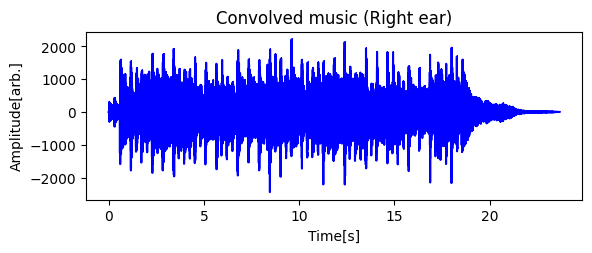

In [93]:
# N点の信号とM点の信号を畳み込むと結果はN+M-1点
result = np.zeros((2, len(wave_data) + hrir_len - 1))
t = np.arange(result.shape[1])*ts

for lr in LR:
    convolve_result[LR[lr]] = np.convolve(hrir[LR[lr]], wave_data.astype(float))
    plt.subplot(2, 1, 1); plt.title("Convolved music (" + lr + " ear)")
    plot_wave(t, convolve_result[LR[lr]])

audio = Audio(convolve_result, rate=fs)
audio

オリジナルの音源と聞き比べると確かに左から聞こえてくる。

HRIRの測定対象であった人と聴取者とでHRIRの個人差があったり、再生時にヘッドホンの特性がかかっていたり、耳を覆う型のヘッドホンで聴取者の耳介の特性がかかったりと、実際の音像定位の制御は難しい。

次は、長い音に対するフィルタリングについて考えてみる。

畳込み(直線畳込み、または線上畳込み)は、計算コストが高いため、継続時間が長い音同士を畳込むと、処理時間が長くかかってしまう。一方で、時間領域での２つの波形の畳込みは、周波数領域のそれぞれのスペクトルの乗算に対応すため、効率よく音を処理できる。